# **Ceng 796 Term Project**

## **Paper: KD-DLGAN: Data Limited Image Generation via Knowledge Distillation**

### **Authors of the paper:**
#### Kaiwen Cui, Yingchen Yu, Fangneng Zhan,  Shengcai Liao,  Shijian Lu, Eric Xing

### **Project group members:**
#### Meric Karadayi: e244855@metu.edu.tr
#### Ibrahim Ersel Yigit: e244907@metu.edu.tr

## **Paper Information:**

### **Summary of the paper:**

Generative Adversarial Networks (GANs) rely heavily on large-scale training data for training. Inpired by the knowledge distillation, the paper proposes KD-DLGAN which cosist of 2 innovative designs. The first is aggregated generative KD that mitigates the discriminator overfitting by challenging the discriminator with harder learning tasks and distilling more generalizable knowledge from the pre-trained models. The second is correlated generative KD that improves the generation diversity by distilling and preserving the diverse image-text correlation within the pre-trained models.

<div>
<img src="./report_images/overview.png" width="750"/>
</div>

### **General Discriminator and Generator Losses**

$$L_d(D; x, G(z)) = \mathbb{E}[log(D(x))] + \mathbb{E}[log(1 - D(G(z)))]$$

$$L_g(D; G(z)) = \mathbb{E}[log(1 - D(G(z)))]$$


### **Aggregated Generative Knowledge Distillation**

Aggregated generative knowledge distillation aims to mitigate the discriminator overfitting by distilling more generalizable knowledge from the pretrained CLIP model.

<div>
<img src="./report_images/agkd-schema.png" width="200"/>
</div>

#### **Objective Loss of Aggregated Generative Knowledge Distillation is follows:**

$$ L_{AGKD} = L_{AGKD}^{KD} + {L'}_{AGKD}^{AGG} $$

where;

$$ L_{AGKD}^{KD} = |I(x) - D^{f}(x)| + |I(G(z)) - D^{f}(G(z))| $$

$$ {L'}_{AGKD}^{AGG} =
\begin{cases}
    {L}_{AGKD}^{AGG} & \text{if } q \leq p \\
    0 & \text{if }  q > p
\end{cases} $$

$$ {L}_{AGKD}^{AGG} = |I(x) - D^{f}(G(z))| + |I(G(z)) - D^{f}(x)| $$

where;

$I \rightarrow $ CLIP features

$D^{f}(G(z)) \rightarrow $ discriminator features

$x \rightarrow$ real samples

$G(z) \rightarrow$ fake samples

$q \rightarrow$ a random number between 0 and 1

$p \rightarrow$ a pre-defined hyper-parameter

### **Correlated Generative Knowledge Distillation**

Correlated generative knowledge distillation $(CGKD)$ aims to improve the generation diversity by two steps: First, it enforces the diverse correlations between generated images and texts in CLIP with a pairwise diversity loss $L_{CGKD}^{PD}$ Second, it distills the diverse correlations from CLIP to the GAN discriminator with a distillation loss $L_{CGKD}^{KD}$.

To be able to achive this, the method of the paper makes use of n $CLIP$ visual features of generated images $I(G(z)) \in \mathbb{R}^{B \times M}$ and CLIP texts features $T \in \mathbb{R}^{K \times M}$ as well as the discriminator features of generated samples $D^f(G(z)) \in \mathbb{R}^{B \times K}$ where $B = batch\_size$, $K = number\_of\_texts$ and $M = features\_dimension$

<div>
<img src="./report_images/cgkd-schema.png" width="200"/>
</div>

#### **Objective Loss of Correlated Generative Knowledge Distillation is follows:**

$$L_{CGKD} = L_{CGKD}^{PD} + L_{CGKD}^{KD}$$

where;

$$C_T = \frac{I(G(z)) \cdot T'}{||I(G(z)) \cdot T'||_2}$$

$$L_{CGKD}^{PD} = \sum_{i=1}^{K}  \sum_{j=1, j \neq i}^{K} \cos(\mathbf{C}_{T}[i,:], \mathbf{C}_{T}[j,:])$$

$$C_S = \frac{D^f(G(z)) \cdot T'}{||D^f(G(z)) \cdot T'||_2}$$

$$L_{CGKD}^{KD} = |C_T - C_S|$$

where;

$I \rightarrow $ CLIP features

$D^{f}(G(z)) \rightarrow $ discriminator features

$G(z) \rightarrow$ fake samples

### **Overall Training Objective:**

$$ \min_G \max_D = L_G + L_D $$

where;

$$ L_G = L_g (equivalent \space to \space general \space loss)$$

and

$$ L_D = L_d + L_{CGKD} + L_{AGKD} $$

## Installing Requirements

In [ ]:
! pip install -r requirements.txt
! git clone https://github.com/mit-han-lab/data-efficient-gans/

## Download Dataset

In [1]:
! bash download_data.sh

Repo card metadata block was not found. Setting CardData to empty.
Generating train split: 100% 100/100 [00:00<00:00, 2437.85 examples/s]
100% 100/100 [00:00<00:00, 186.27it/s]


## Import Libraries

In [2]:
import torch
from IPython.display import Image
from PIL import Image
import matplotlib.pyplot as plt
from tabulate import tabulate

## Our Implementation
Since our paper proposes a new loss formula, we modified the original DiffAugment-StyleGAN2 to integrate this new loss function. Additionally we have implemented 2 classes, CLIP and KDLoss. We are copying those files, modified files and new classes, into the original directory to overwrite the existing ones. These modifications and implemenations will be explained in this section.

### CLIP Feature Extractor
We have implemented a class which extracts the features for both images and texts using the pretrained CLIP model as KD-DLGAN paper suggests.

[CLIP.py](CLIP.py) # TODO link to the file

### Text Label Retriever
TODO

[text_labels.py](text_labels.py) # TODO link to the file

In [ ]:
! cp text_labels.py data-efficient-gans/DiffAugment-stylegan2-pytorch/training/

### KD-DLGAN Loss
We have implemented the KD discriminator loss with the AGKD and CGKD loss formulas, which we explained earlier in KDDiscriminatorLoss. We added this loss to the original loss function of DA-StyleGAN2 with KDLoss. The original DA loss function structure was used to implement the KD loss function  to avoid corrupting the original training code.

[kd_loss.py](kd_loss.py) # TODO link to the file

In [ ]:
! cp kd_loss.py data-efficient-gans/DiffAugment-stylegan2-pytorch/training/

### Modifications on DiffAugment-StyleGAN2
The original training code does not include an argument for specifying the loss function. We have added the necessary loss argument along with its functionalities.


```python
@click.option('--loss', help='Loss function [da, da_kd_agkd, da_kd_cgkd, da_kd_agkd_cgkd]', type=str, required=True)
```
We also modified the DiscriminatorEpilogue class to add functionality enabling it to return the features from the Discriminator's last layer, which are utilized in the AGKD loss.


[train.py](train.py) # TODO link to the file

[networks.py](networks.py) # TODO link to the file

In [ ]:
! cp train.py data-efficient-gans/DiffAugment-stylegan2-pytorch/
! cp networks.py data-efficient-gans/DiffAugment-stylegan2-pytorch/training/

## Hyperparameters

In [ ]:
BATCH_SIZE = 8
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

DATASET = '100-shot-obama'
"""
For version1, it is the only dataset option.
"""

CONFIG = 'low-shot'
"""
'low-shot' corresponds to hyperparameter configuration below:
dict(ref_gpus=-1, kimg=16,    mb=8,  mbstd=4,  fmaps=1,   lrate=0.002,  gamma=10,   ema=10,  ramp=None, map=2, snap=1),
"""

P = 0.5 # probability of applying Aggregated Generative Knowlegde Distillation
"""
We have implemented distillation with default 0.5 value. Changing this parameter would not affect the training.
It is written for informational purposes
"""

CRITERION = 'da_kd_agkd_cgkd'
"""
other options: ['da', 'da_kd_agkd', 'da_kd_cgkd']
"""

PRETRAINED_DATASET = 'ffhq1024'
"""
Dataset used for selecting pretrained model initial weights
"""

## Training Model Section

Due to very long training time, in version 1, we could only perform experiments with configurations:
- DA (Baseline) and both CGKD and AGKD are applied.
- few-shot-obama dataset
- for 160 epochs

The commands for training with StyleGANv2 using DA(Baseline) and proposed distillation method are given below respectiely


In [ ]:
CRITERION = 'da'

! python data-efficient-gans/DiffAugment-stylegan2-pytorch/train.py --outdir=training-runs-kd --data=data-efficient-gans/DiffAugment-stylegan2-pytorch/{DATASET}-dataset --resume={PRETRAINED_DATASET} --loss={CRITERION}

In [ ]:
CRITERION = 'da_kd_agkd_cgkd'

! python data-efficient-gans/DiffAugment-stylegan2-pytorch/train.py --outdir=training-runs-kd --data=data-efficient-gans/DiffAugment-stylegan2-pytorch/{DATASET}-dataset --resume={PRETRAINED_DATASET} --loss={CRITERION}

## Loading Model and Computing Quialitative Samples

### Generating by using DA

In [ ]:
DA_OUTPUT_DIR = "DA-generated-outputs"
! python data-efficient-gans/DiffAugment-stylegan2-pytorch/generate.py --network=DA-network-snapshot.pkl --outdir={DA_OUTPUT_DIR} --seeds=1-100

Loading networks from "DA-network-snapshot.pkl"...
Generating image for seed 1 (0/100) ...
Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "upfirdn2d_plugin"... Done.
Generating image for seed 2 (1/100) ...
Generating image for seed 3 (2/100) ...
Generating image for seed 4 (3/100) ...
Generating image for seed 5 (4/100) ...
Generating image for seed 6 (5/100) ...
Generating image for seed 7 (6/100) ...
Generating image for seed 8 (7/100) ...
Generating image for seed 9 (8/100) ...
Generating image for seed 10 (9/100) ...
Generating image for seed 11 (10/100) ...
Generating image for seed 12 (11/100) ...
Generating image for seed 13 (12/100) ...
Generating image for seed 14 (13/100) ...
Generating image for seed 15 (14/100) ...
Generating image for seed 16 (15/100) ...
Generating image for seed 17 (16/100) ...
Generating image for seed 18 (17/100) ...
Generating image for seed 19 (18/100) ...
Generating image for seed 20 (19/100) ...
Generating image for 

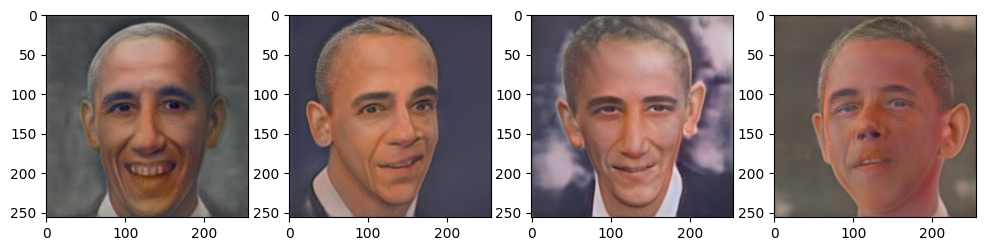

In [ ]:
fig = plt.figure(figsize=(12, 6))
for i in range(1,5):
  fig.add_subplot(140+i).imshow(Image.open(f"{DA_OUTPUT_DIR}/seed000{i}.png"))
plt.show()

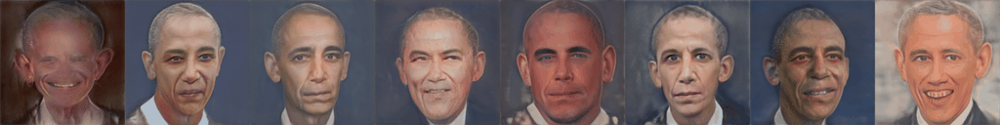

In [ ]:
! python data-efficient-gans/DiffAugment-stylegan2-pytorch/generate_gif.py --network=DA-network-snapshot.pkl --seed=1 --output "DA-output"
Image(open('DA-output.gif','rb').read())

### Generating by using KD-DLGAN

In [ ]:
KD_OUTPUT_DIR = "KD-generated-outputs"
! python data-efficient-gans/DiffAugment-stylegan2-pytorch/generate.py --network=KD-network-snapshot.pkl --outdir={KD_OUTPUT_DIR} --seeds=1-100

Loading networks from "KD-network-snapshot.pkl"...
Generating image for seed 1 (0/100) ...
Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "upfirdn2d_plugin"... Done.
Generating image for seed 2 (1/100) ...
Generating image for seed 3 (2/100) ...
Generating image for seed 4 (3/100) ...
Generating image for seed 5 (4/100) ...
Generating image for seed 6 (5/100) ...
Generating image for seed 7 (6/100) ...
Generating image for seed 8 (7/100) ...
Generating image for seed 9 (8/100) ...
Generating image for seed 10 (9/100) ...
Generating image for seed 11 (10/100) ...
Generating image for seed 12 (11/100) ...
Generating image for seed 13 (12/100) ...
Generating image for seed 14 (13/100) ...
Generating image for seed 15 (14/100) ...
Generating image for seed 16 (15/100) ...
Generating image for seed 17 (16/100) ...
Generating image for seed 18 (17/100) ...
Generating image for seed 19 (18/100) ...
Generating image for seed 20 (19/100) ...
Generating image for 

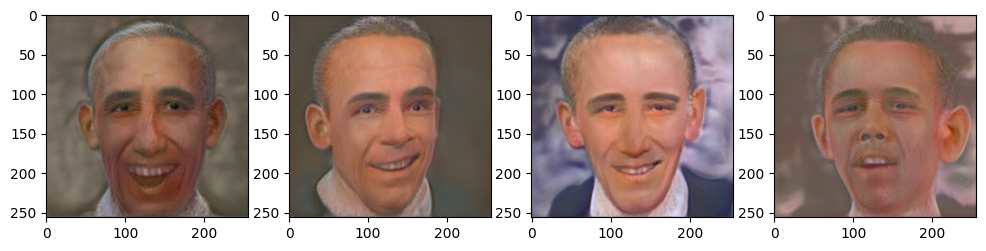

In [ ]:
fig = plt.figure(figsize=(12, 6))
for i in range(1,5):
  fig.add_subplot(140+i).imshow(Image.open(f"{KD_OUTPUT_DIR}/seed000{i}.png"))
plt.show()

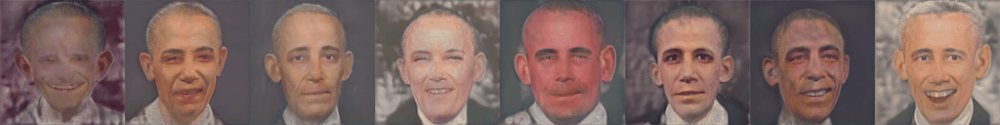

In [ ]:
! python data-efficient-gans/DiffAugment-stylegan2-pytorch/generate_gif.py --network=KD-network-snapshot.pkl --seed=1 --output "KD-output"
Image(open('KD-output.gif','rb').read())

## Reproducing the Results

### FID scores of DA

In [ ]:
! python data-efficient-gans/DiffAugment-stylegan2-pytorch/calc_metrics.py --network=DA-network-snapshot.pkl --metrics=fid50k_full --verbose=False --data=real-image

{"results": {"fid50k_full": 68.26554484482897}, "metric": "fid50k_full", "total_time": 500.4793334007263, "total_time_str": "8m 20s", "num_gpus": 1, "snapshot_pkl": "DA-network-snapshot.pkl", "timestamp": 1714934993.4847326}


### FID scores of KD-DLGAN

In [ ]:
! python data-efficient-gans/DiffAugment-stylegan2-pytorch/calc_metrics.py --network=KD-network-snapshot.pkl --metrics=fid50k_full --verbose=False --data=real-image

{"results": {"fid50k_full": 119.92057567469203}, "metric": "fid50k_full", "total_time": 499.13370990753174, "total_time_str": "8m 19s", "num_gpus": 1, "snapshot_pkl": "KD-network-snapshot.pkl", "timestamp": 1714935496.7204456}


### Comparison with original paper

In [ ]:
table = [['', 'Our', 'Paper'], ["DA (Baseline)", 68.27, 46.87], ["KD-DLGAN", 119.92, 31.54]]
print(tabulate(table, headers='firstrow', tablefmt='fancy_grid'))

╒═══════════════╤════════╤═════════╕
│               │    Our │   Paper │
╞═══════════════╪════════╪═════════╡
│ DA (Baseline) │  68.27 │   46.87 │
├───────────────┼────────┼─────────┤
│ KD-DLGAN      │ 119.92 │   31.54 │
╘═══════════════╧════════╧═════════╛


#### Notes
In the DA paper, the recommended number of epochs was 3000. However, due to time concerns in training KD-DLGAN, we could only train for 160 epochs. Therefore, neither model matched our goals in terms of FID scores.


## Challanges

- In the part of the paper where we attempt to reproduce experimental result goals, the authors do not specify the architecture they used (BigGAN vs StyleGANv2). Therefore, we have tried both and decided to use StyleGANv2 due to its easier training opportunities.

- They also did not explicitly describe the training process and hyperparameters extensively, so we have used the default StyleGANv2 parameters and DA settings.

- Due to the existence of KD_DLGAN distillation algorithms, training takes significantly more time. Therefore, we can only train for 160 epochs (16,000 images), which prevents us from obtaining reliable results. We may perform longer trainings.